In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
from pandas.plotting import autocorrelation_plot

import matplotlib.pyplot as plt
import seaborn as sns

import os, gc
import pickle
import datetime, time
from tqdm import tqdm_notebook as tqdm


from sklearn import preprocessing

%matplotlib inline

In [2]:
#path = '/Users/kanoumotoharu/Downloads/m5-forecasting-accuracy/'
path = '/Users/abcdm/Downloads/m5-forecasting-accuracy/'
#path = '../input/m5-forecasting-accuracy/'

In [3]:
%%time
train_df = pd.read_csv(path+'sales_train_validation.csv')
calendar_df = pd.read_csv(path+'calendar.csv')
sell_prices_df = pd.read_csv(path+'sell_prices.csv')
sample_submission_df = pd.read_csv(path+'sample_submission.csv')

Wall time: 4.57 s


In [4]:
d_cols = [f'd_{i+1}' for i in range(1913)]

In [5]:
train_df

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,3,0,1,1,1,3,0,1,1
1,HOBBIES_1_002_CA_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,HOBBIES_1_003_CA_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,2,1,1,1,0,1,1,1
3,HOBBIES_1_004_CA_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,1,0,5,4,1,0,1,3,7,2
4,HOBBIES_1_005_CA_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,...,2,1,1,0,1,1,2,2,2,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30485,FOODS_3_823_WI_3_validation,FOODS_3_823,FOODS_3,FOODS,WI_3,WI,0,0,2,2,...,2,0,0,0,0,0,1,0,0,1
30486,FOODS_3_824_WI_3_validation,FOODS_3_824,FOODS_3,FOODS,WI_3,WI,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
30487,FOODS_3_825_WI_3_validation,FOODS_3_825,FOODS_3,FOODS,WI_3,WI,0,6,0,2,...,2,1,0,2,0,1,0,0,1,0
30488,FOODS_3_826_WI_3_validation,FOODS_3_826,FOODS_3,FOODS,WI_3,WI,0,0,0,0,...,0,0,1,0,0,1,0,3,1,3


In [6]:
sell_prices_df['d'] = sell_prices_df.wm_yr_wk.map(calendar_df.set_index('wm_yr_wk')['d'].to_dict())

In [7]:
sell_prices_df

,store_id,item_id,wm_yr_wk,sell_price,d
0,CA_1,HOBBIES_1_001,11325,9.58,d_903
1,CA_1,HOBBIES_1_001,11326,9.58,d_910
2,CA_1,HOBBIES_1_001,11327,8.26,d_917
3,CA_1,HOBBIES_1_001,11328,8.26,d_924
4,CA_1,HOBBIES_1_001,11329,8.26,d_931
...,...,...,...,...,...
6841116,WI_3,FOODS_3_827,11617,1.00,d_1946
6841117,WI_3,FOODS_3_827,11618,1.00,d_1953
6841118,WI_3,FOODS_3_827,11619,1.00,d_1960
6841119,WI_3,FOODS_3_827,11620,1.00,d_1967


In [8]:
train_df.index = train_df.id
data = train_df[d_cols]

In [9]:
data

,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
id,,,,,,,,,,,,,,,,,,,,,
HOBBIES_1_001_CA_1_validation,0,0,0,0,0,0,0,0,0,0,...,1,3,0,1,1,1,3,0,1,1
HOBBIES_1_002_CA_1_validation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
HOBBIES_1_003_CA_1_validation,0,0,0,0,0,0,0,0,0,0,...,2,1,2,1,1,1,0,1,1,1
HOBBIES_1_004_CA_1_validation,0,0,0,0,0,0,0,0,0,0,...,1,0,5,4,1,0,1,3,7,2
HOBBIES_1_005_CA_1_validation,0,0,0,0,0,0,0,0,0,0,...,2,1,1,0,1,1,2,2,2,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FOODS_3_823_WI_3_validation,0,0,2,2,0,3,1,4,1,0,...,2,0,0,0,0,0,1,0,0,1
FOODS_3_824_WI_3_validation,0,0,0,0,0,5,0,1,1,3,...,0,0,0,0,0,0,0,0,1,0
FOODS_3_825_WI_3_validation,0,6,0,2,2,4,1,8,5,2,...,2,1,0,2,0,1,0,0,1,0


In [10]:
sell_prices_df['id'] = sell_prices_df['item_id'].astype('str')+'_'+sell_prices_df['store_id']+'_validation'

In [11]:
wm_yr_wk = calendar_df.wm_yr_wk

In [12]:
sell_prices_df['sell_price'] = sell_prices_df['sell_price'].replace(0, np.nan)

In [13]:
tmp = sell_prices_df.groupby(['id'])[['wm_yr_wk', 'sell_price']].apply(
        lambda x: x.set_index('wm_yr_wk')['sell_price'].to_dict()
    ).to_dict()

In [14]:
price_data = {}
for col in train_df.id.unique():
    price_data[col] = wm_yr_wk.map(tmp[col])

In [15]:
price_data = pd.DataFrame(price_data)

In [16]:
price_data.index = calendar_df.d

In [17]:
price_data = price_data.T.astype(float)

In [18]:
data2 = data.loc[train_df.id, d_cols]*price_data.loc[train_df.id, d_cols]

In [19]:
data2

,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
id,,,,,,,,,,,,,,,,,,,,,
HOBBIES_1_001_CA_1_validation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.38,25.14,0.00,8.38,8.38,8.38,25.14,0.00,8.38,8.38
HOBBIES_1_002_CA_1_validation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.00,0.00,0.00,0.00,0.00,3.97,0.00,0.00,0.00,0.00
HOBBIES_1_003_CA_1_validation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.94,2.97,5.94,2.97,2.97,2.97,0.00,2.97,2.97,2.97
HOBBIES_1_004_CA_1_validation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.64,0.00,23.20,18.56,4.64,0.00,4.64,13.92,32.48,9.28
HOBBIES_1_005_CA_1_validation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.76,2.88,2.88,0.00,2.88,2.88,5.76,5.76,5.76,11.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FOODS_3_823_WI_3_validation,0.0,0.0,5.0,5.0,0.0,7.50,2.5,10.00,2.50,0.00,...,5.96,0.00,0.00,0.00,0.00,0.00,2.98,0.00,0.00,2.98
FOODS_3_824_WI_3_validation,0.0,0.0,0.0,0.0,0.0,12.35,0.0,2.47,2.47,7.41,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.48,0.00
FOODS_3_825_WI_3_validation,0.0,24.0,0.0,8.0,8.0,16.00,4.0,32.00,20.00,8.00,...,7.96,3.98,0.00,7.96,0.00,3.98,0.00,0.00,3.98,0.00


In [20]:
data = data2[d_cols[-100:]].T.astype(float)

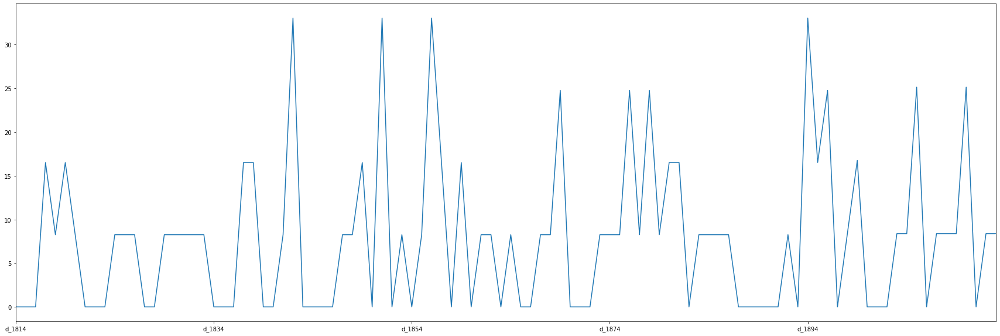

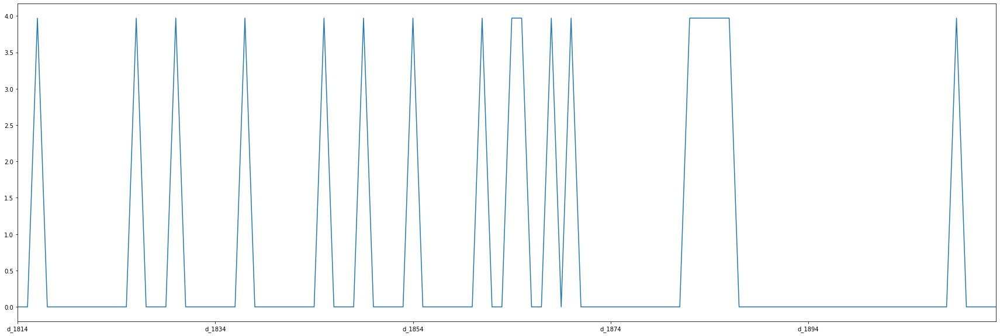

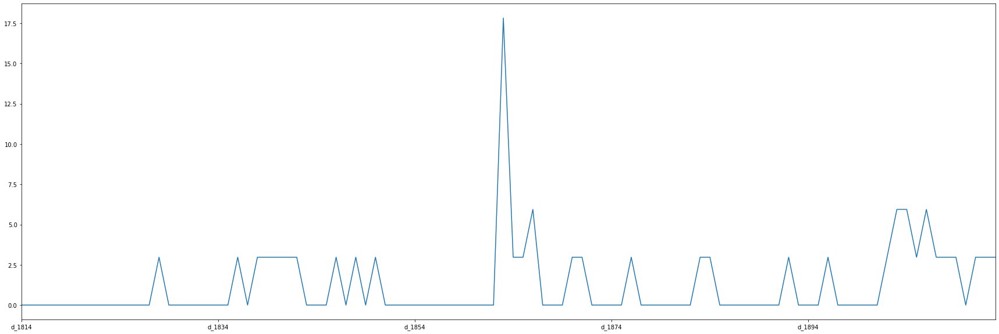

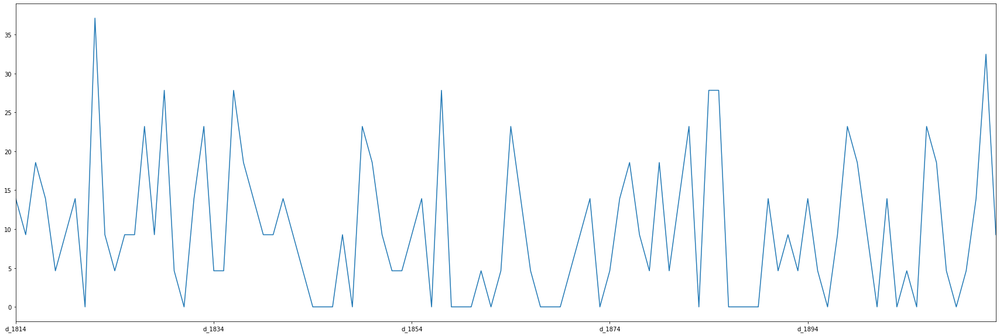

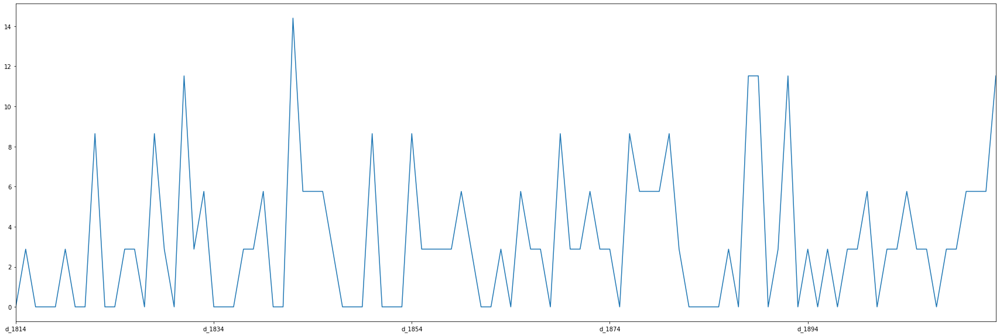

...

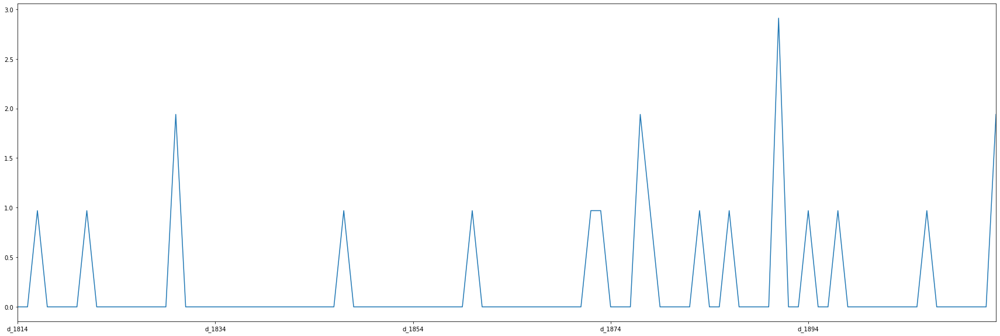

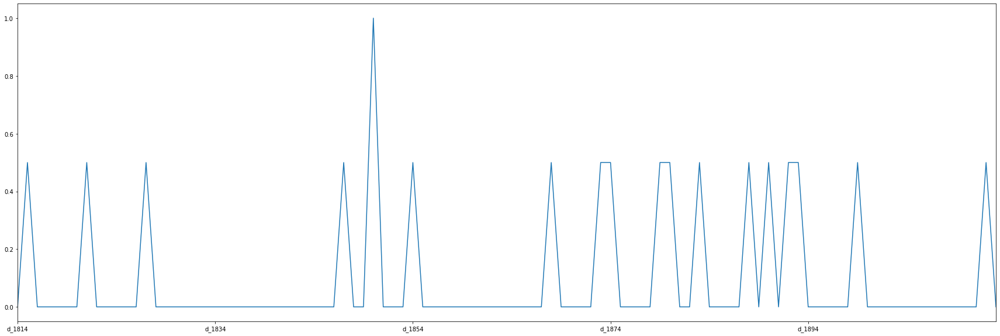

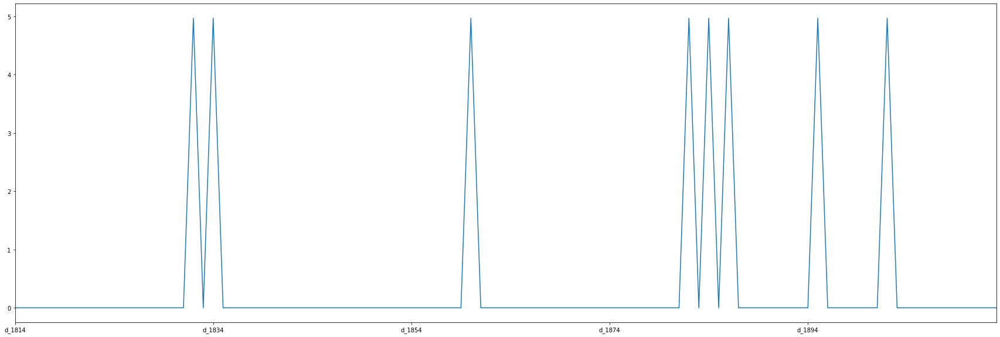

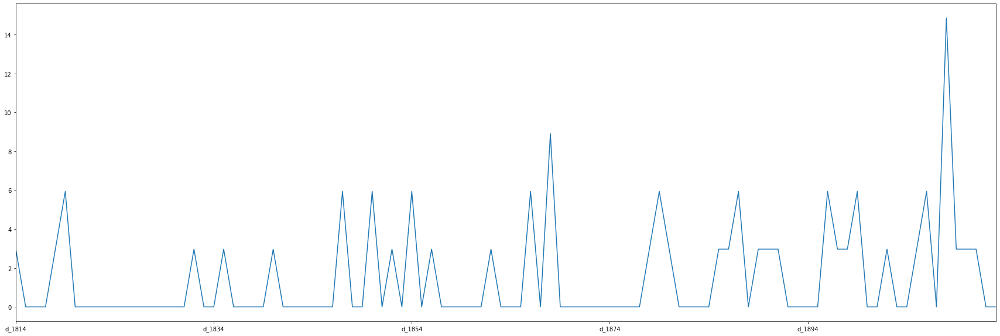

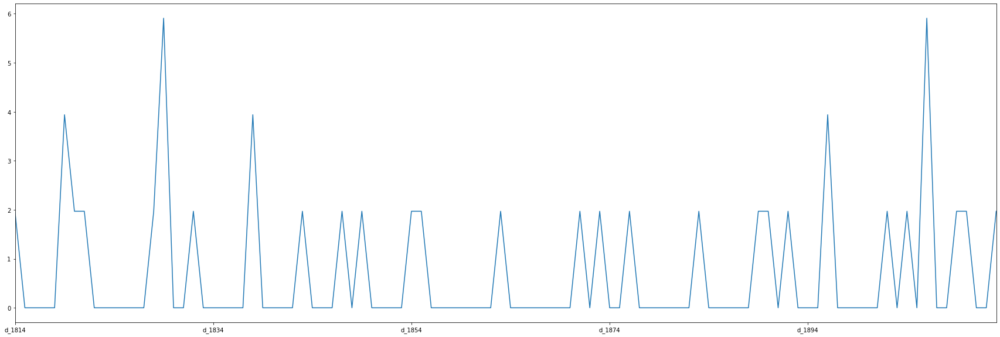

KeyboardInterrupt: 

In [67]:
"""
for col in data.columns:
    data[col].plot(figsize=(30,10))
    plt.show()
"""

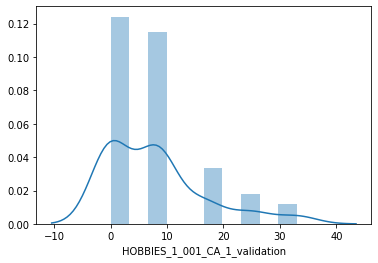

In [86]:
sns.distplot(data['HOBBIES_1_001_CA_1_validation'].dropna())

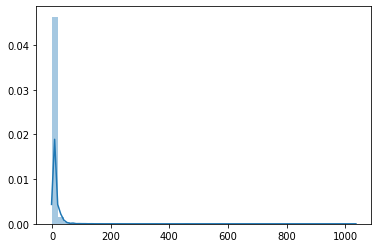

In [72]:
#sns.distplot(data.stack().dropna())

In [90]:
s = data.std(0)
s.sort_values()

id
HOUSEHOLD_2_103_TX_3_validation      0.000000
HOBBIES_1_299_CA_4_validation        0.000000
FOODS_3_243_CA_2_validation          0.000000
HOUSEHOLD_1_058_CA_1_validation      0.000000
FOODS_2_129_TX_3_validation          0.000000
                                      ...    
HOBBIES_1_354_TX_2_validation      116.146691
FOODS_3_120_CA_3_validation        150.066767
FOODS_3_120_CA_1_validation        153.928234
HOBBIES_1_158_TX_3_validation      170.549236
HOBBIES_1_354_TX_3_validation      196.568061
Length: 30490, dtype: float64

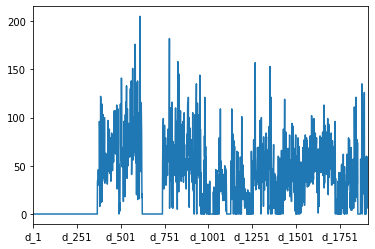

In [96]:
train_df.loc['FOODS_3_120_CA_1_validation', d_cols].plot()

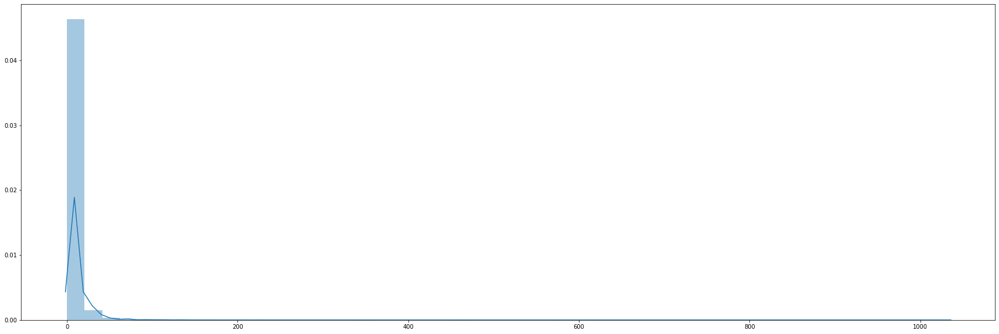

In [103]:
plt.figure(figsize=(30,10))
sns.distplot(data.stack().dropna())

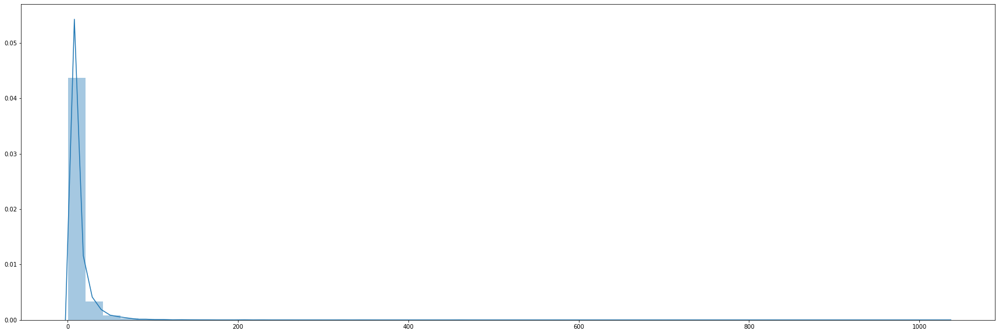

In [104]:
plt.figure(figsize=(30,10))
a = data.stack()
a = a[a>0]
sns.distplot(a.dropna())

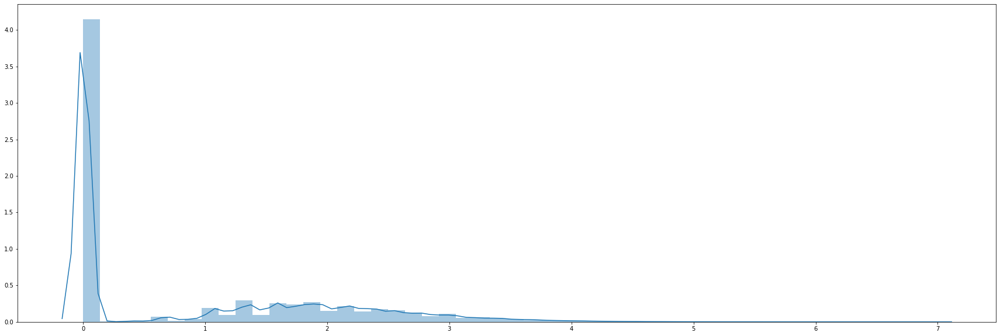

In [111]:
plt.figure(figsize=(30,10))
a = data.stack()
a = np.log1p(a)
sns.distplot(a.dropna())

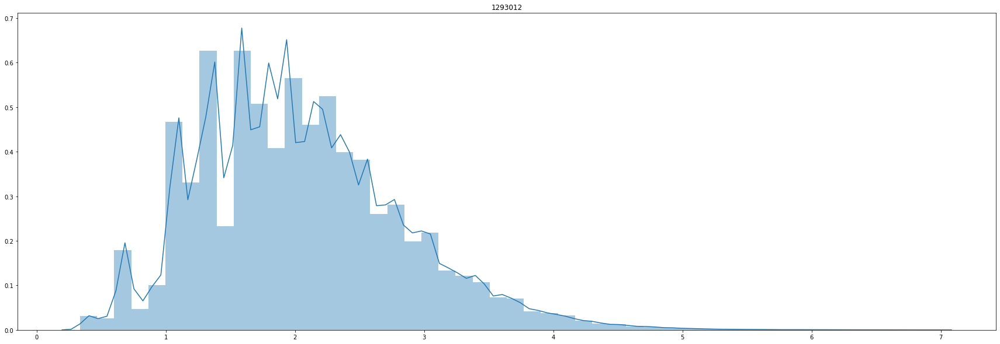

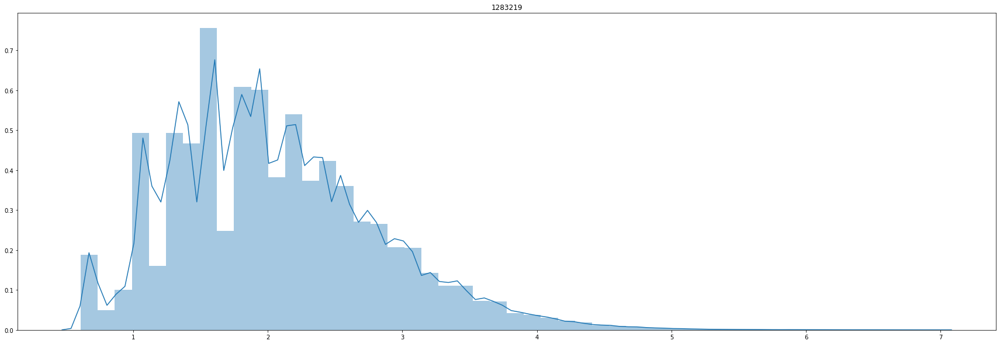

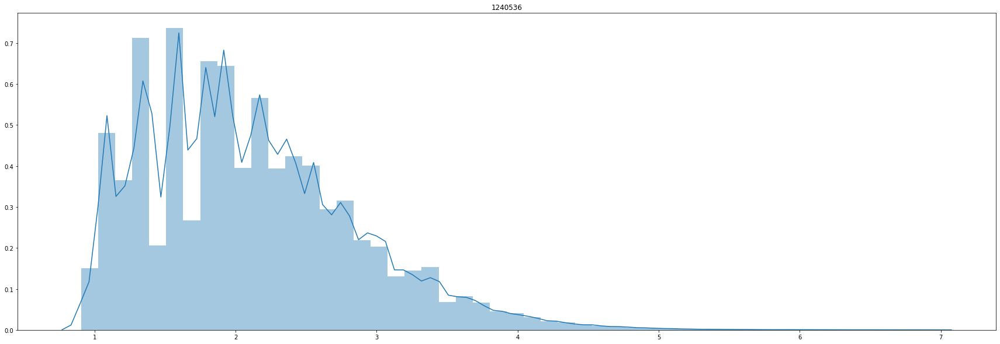

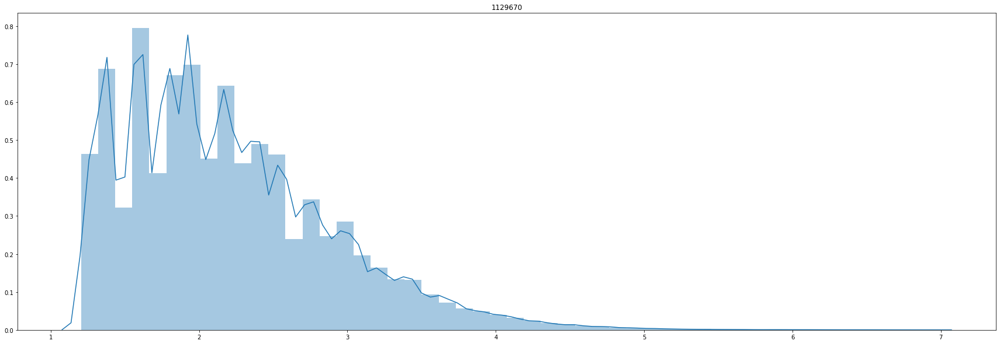

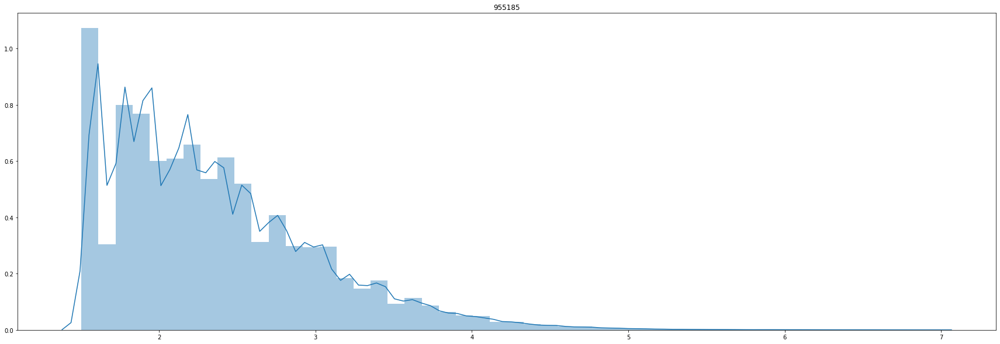

...

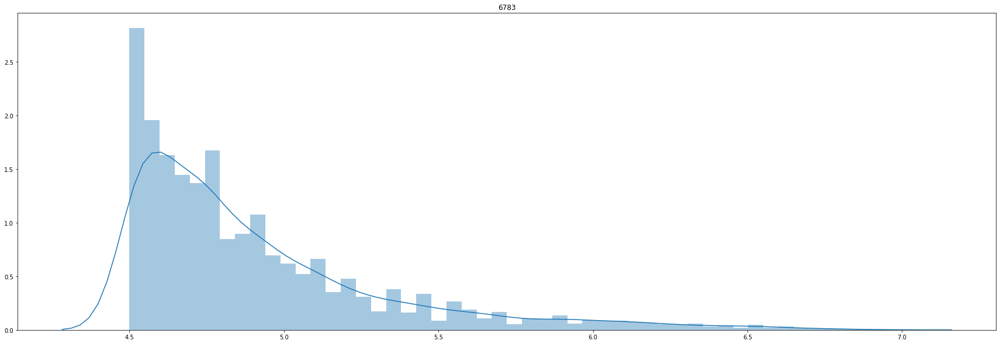

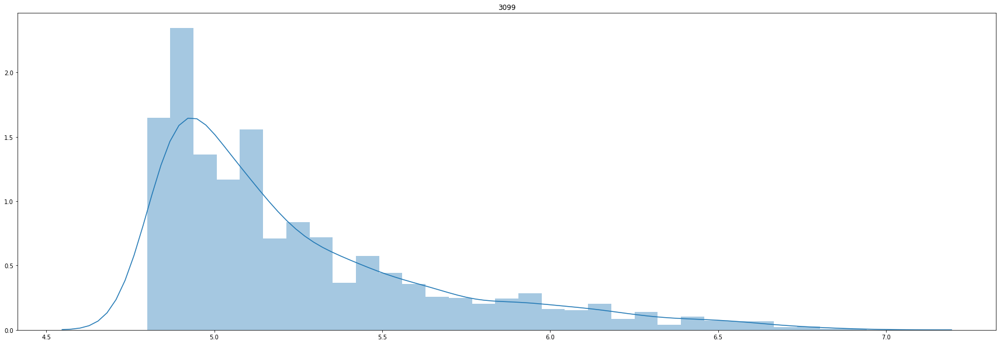

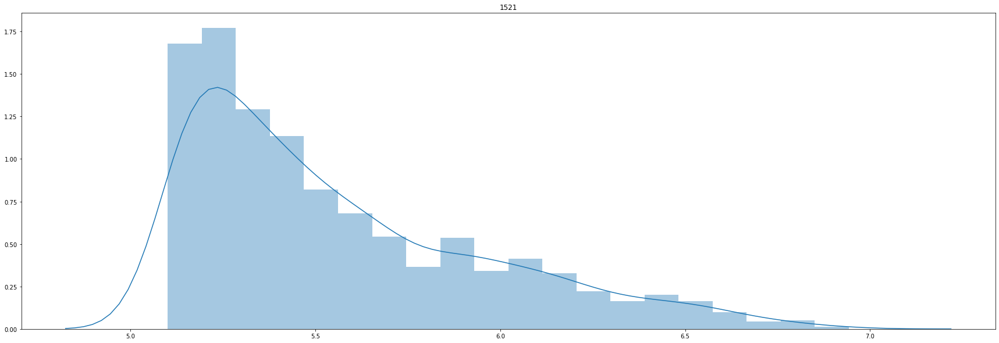

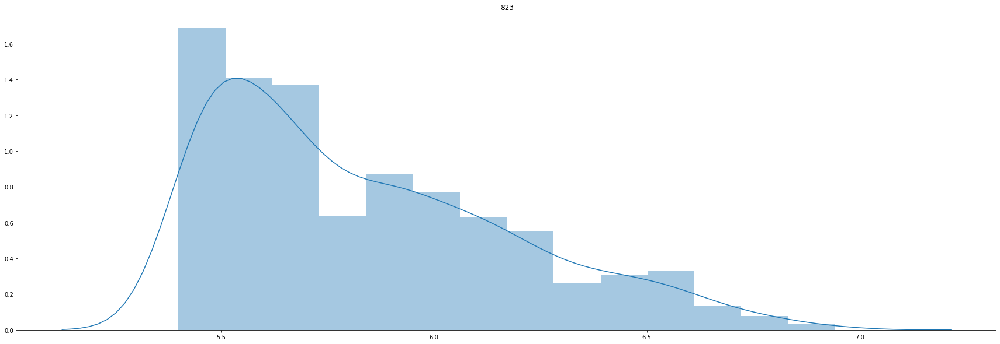

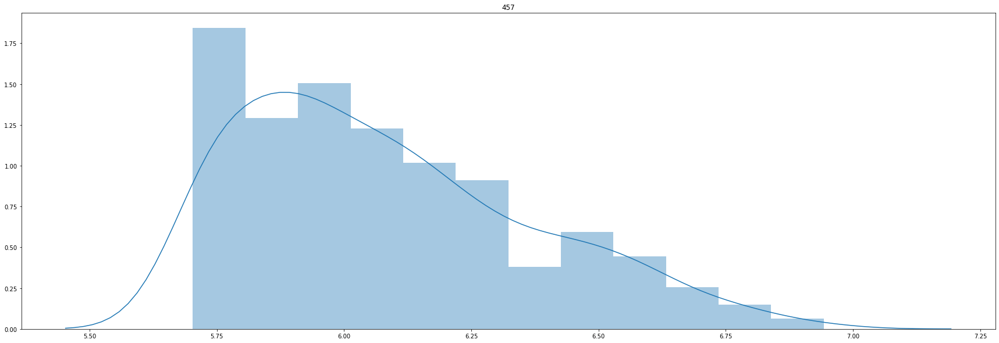

In [110]:
a = data.stack()
a = np.log1p(a)
a = a[a>0]
for i in range(1,20):
    b = a[a>0.3*i]
    plt.figure(figsize=(30,10))
    sns.distplot(b.dropna())
    plt.title(len(b))
    plt.show()

In [124]:
ids = data.mean(0).sort_values().index[-100:]

In [127]:
a = data[ids].stack().reset_index()

In [129]:
a.columns = ['d', 'id', 'target']

In [132]:
a['shift_1'] = a.groupby(['id'])['target'].apply(lambda x: x.shift(7))

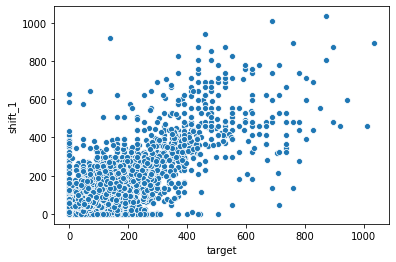

In [134]:
sns.scatterplot(
    a.target, a.shift_1
)

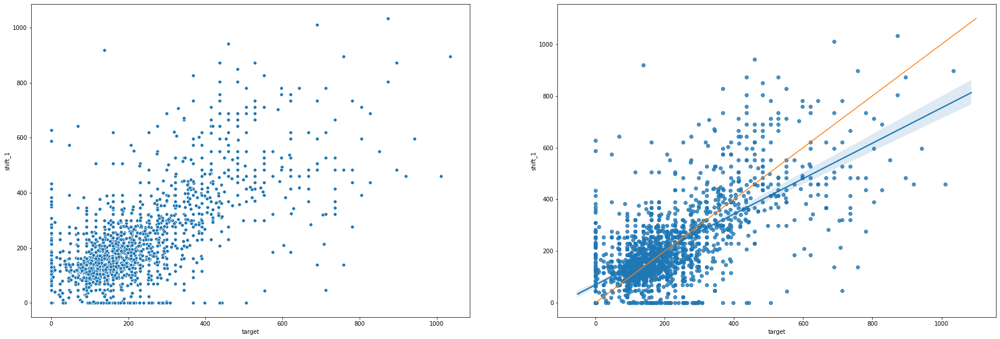

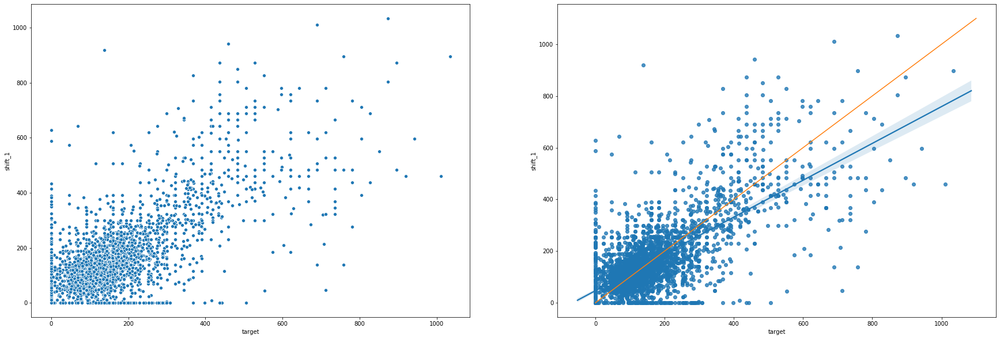

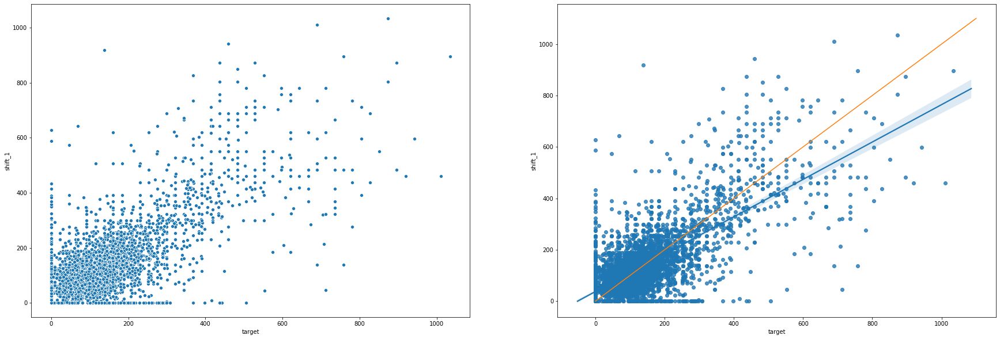

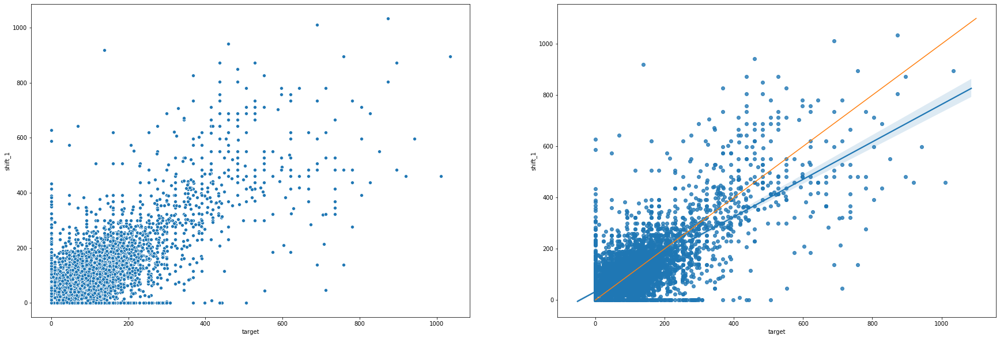

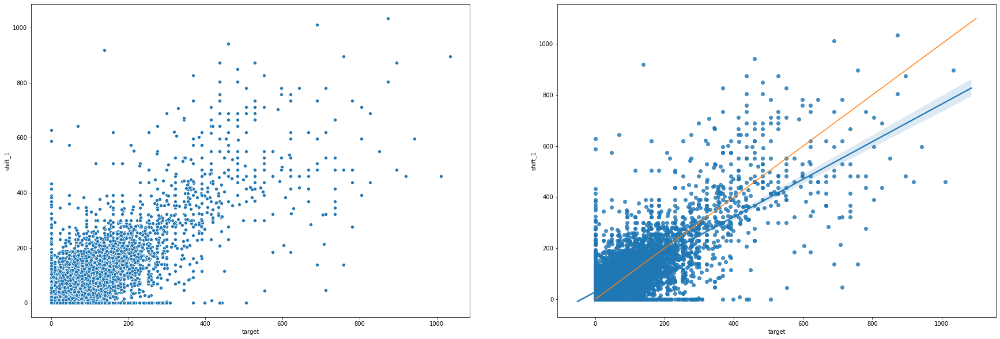

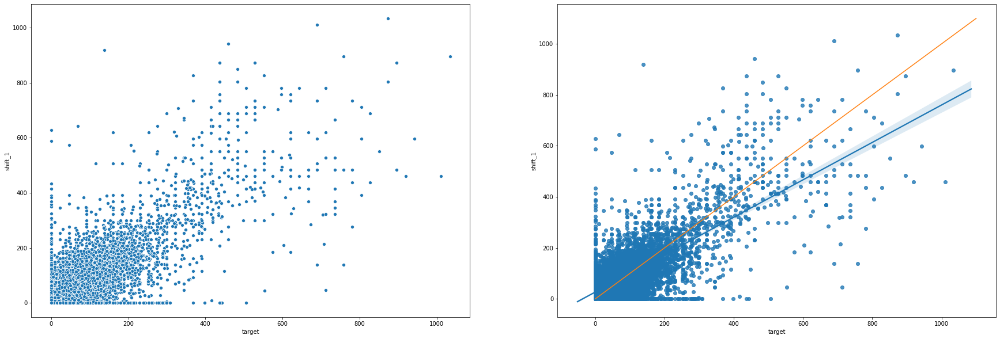

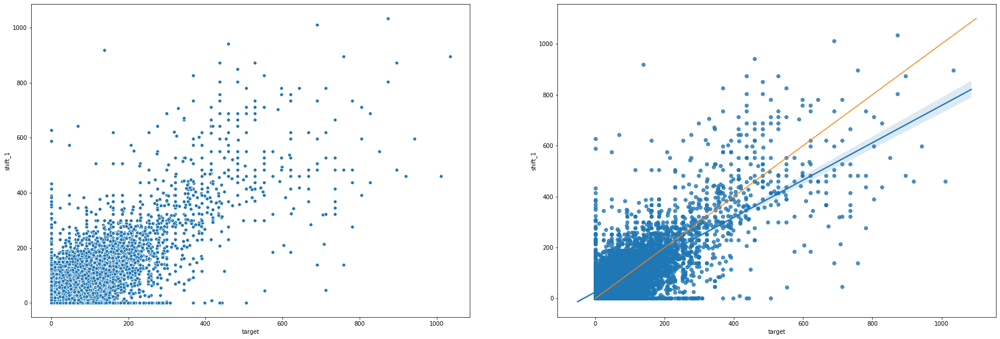

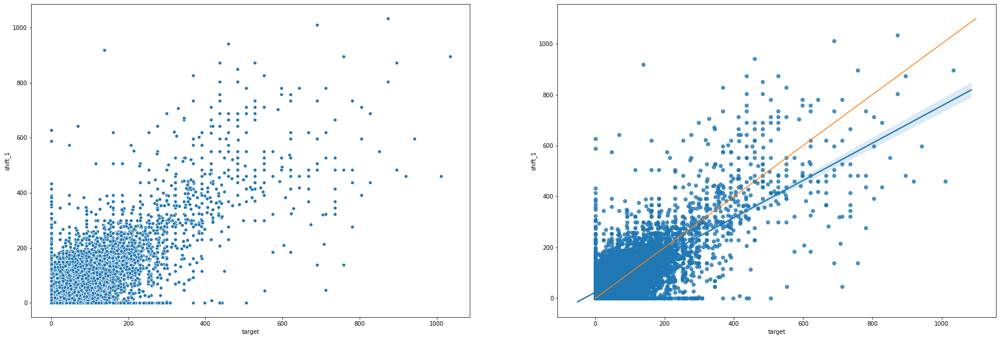

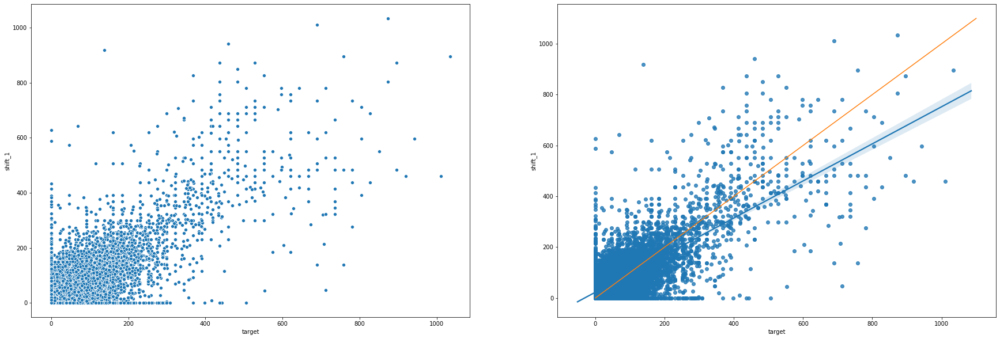

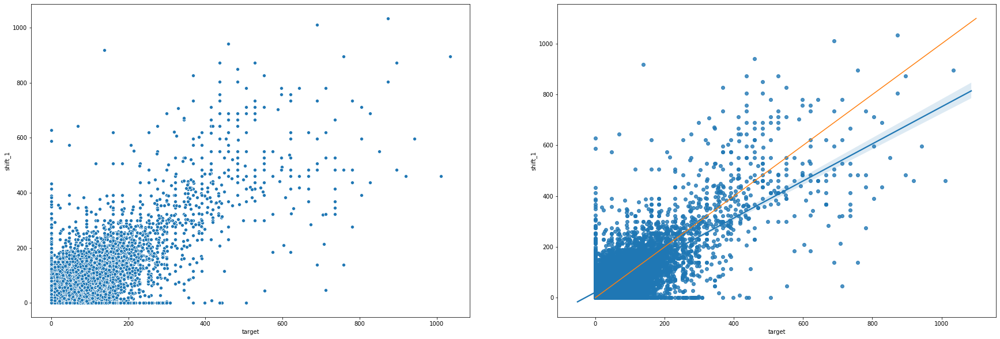

In [142]:
for i in range(10):
    ids = data.mean(0).sort_values().index[-20*(i+1):]
    a = data[ids].stack().reset_index()
    a.columns = ['d', 'id', 'target']
    a['shift_1'] = a.groupby(['id'])['target'].apply(lambda x: x.shift(7))
    
    plt.figure(figsize=(30,10))
    plt.subplot(1,2,1)
    sns.scatterplot(
        a.target, a.shift_1
    )
    plt.subplot(1,2,2)
    sns.regplot(
        a.target, a.shift_1
    )
    plt.plot([0,1100], [0,1100])
    plt.show()

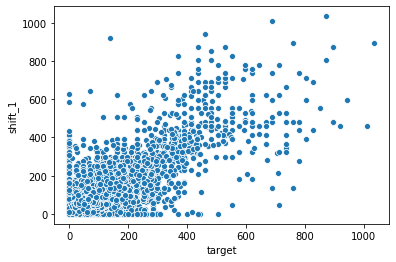

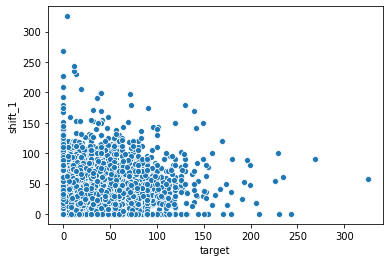

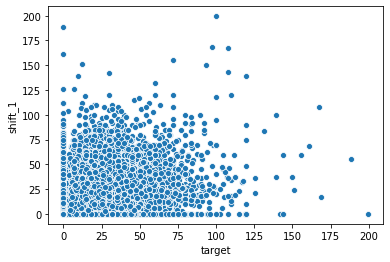

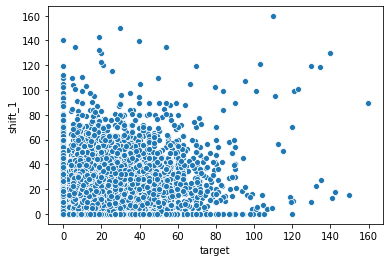

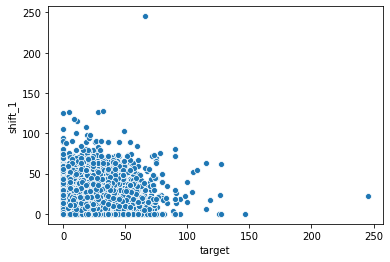

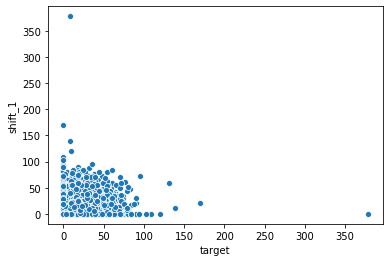

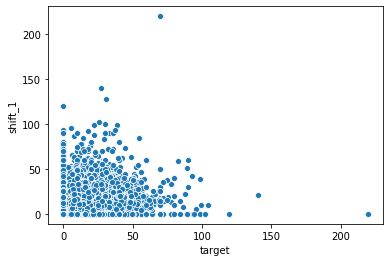

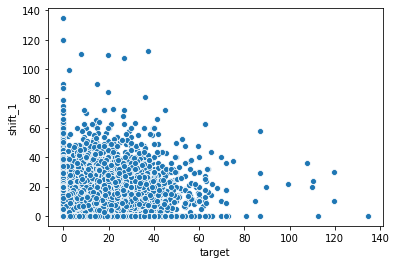

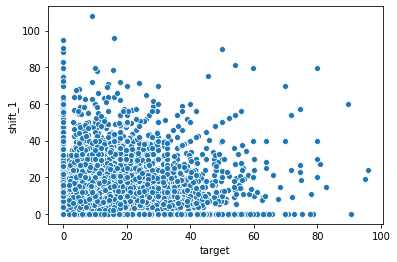

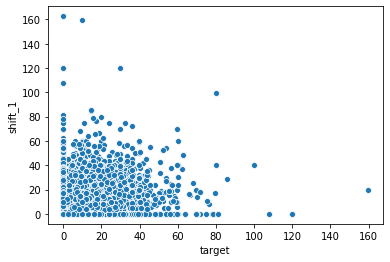

In [137]:
for i in range(10):
    if i==0:
        ids = data.mean(0).sort_values().index[-300*(i+1):]
        a = data[ids].stack().reset_index()
        a.columns = ['d', 'id', 'target']
        a['shift_1'] = a.groupby(['id'])['target'].apply(lambda x: x.shift(7))
        sns.scatterplot(
            a.target, a.shift_1
        )
        plt.show()
    else:
        ids = data.mean(0).sort_values().index[-300*(i+1):-300*(i)]
        a = data[ids].stack().reset_index()
        a.columns = ['d', 'id', 'target']
        a['shift_1'] = a.groupby(['id'])['target'].apply(lambda x: x.shift(7))
        sns.scatterplot(
            a.target, a.shift_1
        )
        plt.show()

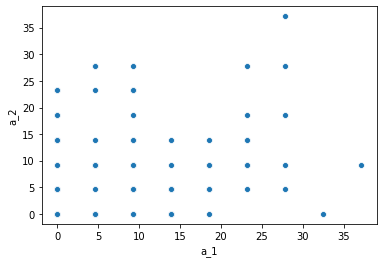

In [118]:
a = pd.concat([
    data['HOBBIES_1_004_CA_1_validation'],
    data['HOBBIES_1_004_CA_1_validation'].shift(7)
], axis=1)
a.columns = ['a_1', 'a_2']
sns.scatterplot(
    a['a_1'],
    a['a_2']
)

In [21]:
data = data.stack().reset_index().rename(columns={'level_0': 'd', 0:'TARGET'})

In [22]:
data = pd.merge(
    train_df[d_cols[-100:]].stack().reset_index().rename(columns={'level_1': 'd', 0:'TARGET2'}),
    data,
    on=['id', 'd']
)

In [23]:
data = pd.merge(
    data2[d_cols[-100:]].T.shift(7).stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET'}),
    data,
    on=['id', 'd']
)

In [38]:
data = pd.merge(
    data2[d_cols[-100:]].T.shift(14).stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET_14'}),
    data,
    on=['id', 'd']
)

In [46]:
for i in range(3,9):
    data = pd.merge(
        data2[d_cols[-100:]].T.shift(7*i).stack().reset_index().rename(columns={'level_0': 'd', 0:f'shift_TARGET_{7*i}'}),
        data,
        on=['id', 'd']
    )

In [70]:
for i in range(2,3):
    data = pd.merge(
        data2[d_cols[-100:]].T.shift(7*i).stack().reset_index().rename(columns={'level_0': 'd', 0:f'shift_TARGET_{7*i}'}),
        data,
        on=['id', 'd']
    )

In [24]:
data = pd.merge(
    train_df[d_cols[-100:]].T.shift(7).stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET2'}),
    data,
    on=['id', 'd']
)

In [69]:
for i in range(2,9):
    data = pd.merge(
        train_df[d_cols[-100:]].T.shift(7*i).stack().reset_index().rename(columns={'level_0': 'd', 0:f'shift_TARGET2_{7*i}'}),
        data,
        on=['id', 'd']
    )

In [58]:
data = pd.merge(
    data2[d_cols[-100:]].T.shift(1).rolling(28, min_periods=1).skew().stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET_skew'}),
    data,
    on=['id', 'd']
)

data = pd.merge(
    data2[d_cols[-100:]].T.shift(1).rolling(28, min_periods=1).std().stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET_std'}),
    data,
    on=['id', 'd']
)

data = pd.merge(
    data2[d_cols[-100:]].T.shift(1).rolling(28, min_periods=1).mean().stack().reset_index().rename(columns={'level_0': 'd', 0:'shift_TARGET_mean'}),
    data,
    on=['id', 'd']
)

In [25]:
data

,d,id,shift_TARGET2,shift_TARGET,TARGET2,TARGET
0,d_1821,HOBBIES_1_001_CA_1_validation,0.0,0.00,0,0.00
1,d_1821,HOBBIES_1_002_CA_1_validation,0.0,0.00,0,0.00
2,d_1821,HOBBIES_1_003_CA_1_validation,0.0,0.00,0,0.00
3,d_1821,HOBBIES_1_004_CA_1_validation,3.0,13.92,0,0.00
4,d_1821,HOBBIES_1_005_CA_1_validation,0.0,0.00,0,0.00
...,...,...,...,...,...,...
2835285,d_1913,FOODS_3_823_WI_3_validation,0.0,0.00,1,2.98
2835286,d_1913,FOODS_3_824_WI_3_validation,0.0,0.00,0,0.00
2835287,d_1913,FOODS_3_825_WI_3_validation,0.0,0.00,0,0.00
2835288,d_1913,FOODS_3_826_WI_3_validation,1.0,1.28,3,3.84


In [26]:
data[data.id=='HOBBIES_1_001_CA_1_validation'].head(20)

,d,id,shift_TARGET2,shift_TARGET,TARGET2,TARGET
0,d_1821,HOBBIES_1_001_CA_1_validation,0.0,0.00,0,0.00
30477,d_1822,HOBBIES_1_001_CA_1_validation,0.0,0.00,0,0.00
60954,d_1823,HOBBIES_1_001_CA_1_validation,0.0,0.00,0,0.00
91431,d_1824,HOBBIES_1_001_CA_1_validation,2.0,16.52,1,8.26
121908,d_1825,HOBBIES_1_001_CA_1_validation,1.0,8.26,1,8.26
152385,d_1826,HOBBIES_1_001_CA_1_validation,2.0,16.52,1,8.26
182862,d_1827,HOBBIES_1_001_CA_1_validation,1.0,8.26,0,0.00
213339,d_1828,HOBBIES_1_001_CA_1_validation,0.0,0.00,0,0.00
243818,d_1829,HOBBIES_1_001_CA_1_validation,0.0,0.00,1,8.26
274297,d_1830,HOBBIES_1_001_CA_1_validation,0.0,0.00,1,8.26


In [59]:
s = data.sample(frac=0.2)
s

,d,id,shift_TARGET_mean,shift_TARGET_std,shift_TARGET_skew,shift_TARGET_56,shift_TARGET_49,shift_TARGET_42,shift_TARGET_35,shift_TARGET_28,shift_TARGET_21,shift_TARGET_14,shift_TARGET2,shift_TARGET,TARGET2,TARGET
1241948,d_1913,FOODS_3_385_TX_2_validation,2.554286,4.032027,1.727264,5.96,0.00,0.00,5.96,5.96,2.98,11.92,0.0,0.00,0,0.00
252238,d_1878,HOUSEHOLD_2_345_WI_3_validation,0.208571,1.103656,5.291503,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0,0.00
542869,d_1889,HOBBIES_1_128_CA_3_validation,1.566071,4.805644,3.029606,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0,0.00
689261,d_1894,HOUSEHOLD_2_186_CA_4_validation,2.138571,4.170197,1.472721,0.00,0.00,0.00,0.00,0.00,9.98,0.00,0.0,0.00,0,0.00
828982,d_1899,HOUSEHOLD_1_411_CA_3_validation,13.822857,10.836588,0.924930,6.56,29.52,19.68,36.08,13.12,0.00,19.68,3.0,9.84,11,36.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
802852,d_1898,HOBBIES_2_123_CA_4_validation,0.035714,0.131133,3.519631,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.0,0.50,0,0.00
1142822,d_1910,FOODS_1_108_CA_2_validation,3.214286,3.181045,0.926965,5.00,2.50,2.50,5.00,0.00,2.50,0.00,1.0,2.50,1,2.50
34625,d_1871,HOUSEHOLD_1_330_CA_3_validation,6.568571,4.052494,0.590749,4.84,9.68,4.84,12.10,4.84,12.10,12.10,7.0,16.94,3,7.26
136381,d_1874,HOUSEHOLD_2_122_WI_2_validation,0.994286,2.480184,2.158648,6.97,0.00,0.00,6.96,0.00,6.96,0.00,0.0,0.00,0,0.00


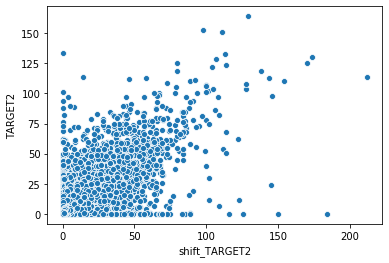

In [34]:
sns.scatterplot(
    s.shift_TARGET2,
    s.TARGET2
)

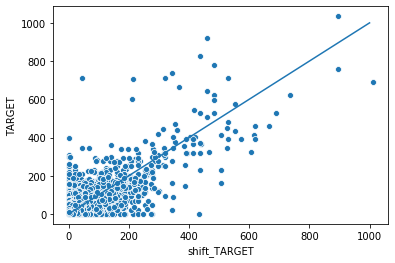

In [43]:
sns.scatterplot(
    s.shift_TARGET,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

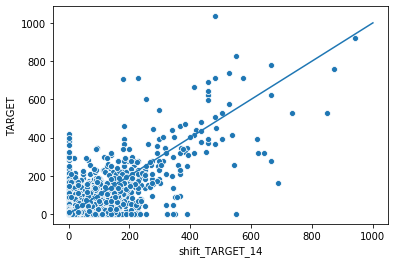

In [44]:
sns.scatterplot(
    s.shift_TARGET_14,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

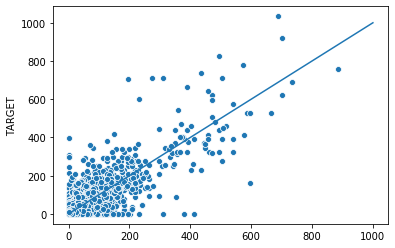

In [45]:
sns.scatterplot(
    (s.shift_TARGET+s.shift_TARGET_14)/2,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

In [47]:
data.corr()

,shift_TARGET_56,shift_TARGET_49,shift_TARGET_42,shift_TARGET_35,shift_TARGET_28,shift_TARGET_21,shift_TARGET_14,shift_TARGET2,shift_TARGET,TARGET2,TARGET
shift_TARGET_56,1.000000,0.708316,0.686094,0.670540,0.675251,0.667941,0.652826,0.417868,0.658569,0.425429,0.664797
shift_TARGET_49,0.708316,1.000000,0.705012,0.673930,0.662982,0.669226,0.661389,0.418414,0.650997,0.424625,0.659113
shift_TARGET_42,0.686094,0.705012,1.000000,0.697968,0.670285,0.663587,0.664942,0.429698,0.661012,0.428934,0.654521
shift_TARGET_35,0.670540,0.673930,0.697968,1.000000,0.694009,0.667619,0.658224,0.441196,0.665723,0.442525,0.663203
shift_TARGET_28,0.675251,0.662982,0.670285,0.694009,1.000000,0.694760,0.664398,0.446339,0.664684,0.456329,0.672504
shift_TARGET_21,0.667941,0.669226,0.663587,0.667619,0.694760,1.000000,0.694235,0.453320,0.672314,0.454555,0.671985
shift_TARGET_14,0.652826,0.661389,0.664942,0.658224,0.664398,0.694235,1.000000,0.475051,0.701510,0.461828,0.676600
shift_TARGET2,0.417868,0.418414,0.429698,0.441196,0.446339,0.453320,0.475051,1.000000,0.675338,0.727619,0.478258
shift_TARGET,0.658569,0.650997,0.661012,0.665723,0.664684,0.672314,0.701510,0.675338,1.000000,0.482992,0.703402
TARGET2,0.425429,0.424625,0.428934,0.442525,0.456329,0.454555,0.461828,0.727619,0.482992,1.000000,0.676950


In [71]:
abs(data.corr()[['TARGET']]).sort_values('TARGET')

,TARGET
shift_TARGET_skew,0.000082
shift_TARGET2_42,0.433330
shift_TARGET2_49,0.437351
shift_TARGET2_35,0.440717
shift_TARGET2_56,0.443397
shift_TARGET2_21,0.446638
shift_TARGET2_28,0.446726
shift_TARGET2_14,0.452238
shift_TARGET2,0.473672
shift_TARGET_42,0.653541


In [50]:
data

,d,id,shift_TARGET_56,shift_TARGET_49,shift_TARGET_42,shift_TARGET_35,shift_TARGET_28,shift_TARGET_21,shift_TARGET_14,shift_TARGET2,shift_TARGET,TARGET2,TARGET
0,d_1870,HOBBIES_1_001_CA_1_validation,0.00,0.00,0.00,0.00,33.04,16.52,33.04,0.0,0.00,0,0.00
1,d_1870,HOBBIES_1_002_CA_1_validation,0.00,0.00,0.00,0.00,0.00,3.97,0.00,0.0,0.00,1,3.97
2,d_1870,HOBBIES_1_003_CA_1_validation,0.00,0.00,2.97,0.00,2.97,0.00,0.00,6.0,17.82,1,2.97
3,d_1870,HOBBIES_1_004_CA_1_validation,13.92,0.00,9.28,4.64,9.28,23.20,0.00,1.0,4.64,1,4.64
4,d_1870,HOBBIES_1_005_CA_1_validation,0.00,0.00,8.64,0.00,14.40,0.00,2.88,1.0,2.88,1,2.88
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341275,d_1913,FOODS_3_823_WI_3_validation,2.88,2.98,0.00,0.00,0.00,0.00,0.00,0.0,0.00,1,2.98
1341276,d_1913,FOODS_3_824_WI_3_validation,0.00,0.00,0.00,0.00,0.00,2.48,2.48,0.0,0.00,0,0.00
1341277,d_1913,FOODS_3_825_WI_3_validation,0.00,7.96,3.98,0.00,3.98,3.98,7.96,0.0,0.00,0,0.00
1341278,d_1913,FOODS_3_826_WI_3_validation,0.00,2.56,3.84,1.28,5.12,1.28,2.56,1.0,1.28,3,3.84


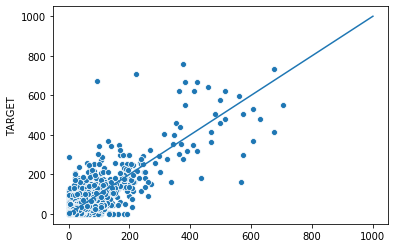

In [55]:
sns.scatterplot(
    (s.shift_TARGET+s.shift_TARGET_14+s.shift_TARGET_21)/3,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

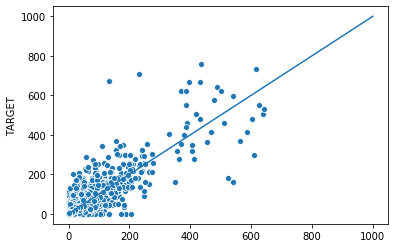

In [57]:
sns.scatterplot(
    (s.shift_TARGET+s.shift_TARGET_14+s.shift_TARGET_21+s.shift_TARGET_28)/4,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

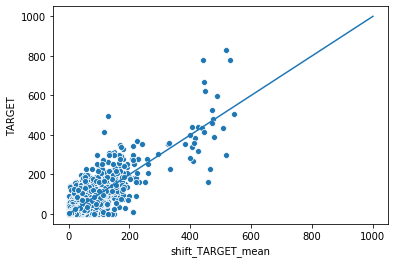

In [61]:
sns.scatterplot(
    s.shift_TARGET_mean,
    s.TARGET
)
plt.plot([0,1000], [0,1000])

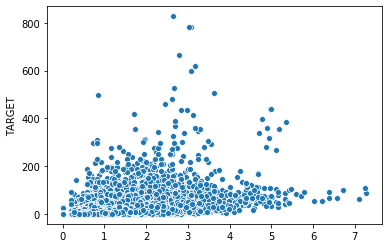

In [64]:
sns.scatterplot(
    s.shift_TARGET_mean/s.shift_TARGET_std,
    s.TARGET
)
#plt.plot([0,1000], [0,1000])

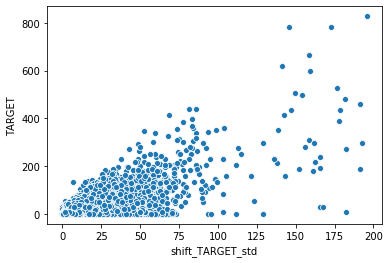

In [65]:
sns.scatterplot(
    s.shift_TARGET_std,
    s.TARGET
)
#plt.plot([0,1000], [0,1000])

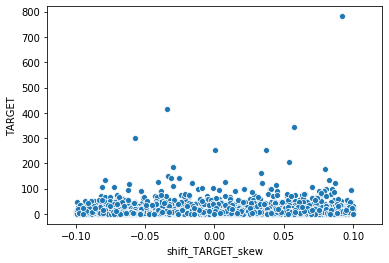

In [67]:
sns.scatterplot(
    s[abs(s.shift_TARGET_skew)<0.1].shift_TARGET_skew,
    s[abs(s.shift_TARGET_skew)<0.1].TARGET
)